In [1]:
import pandas as pd
from math import pi
import numpy as np
from numpy import average
import itertools
import json

import copy 
import ipywidgets as widgets
from ipywidgets import interact, interactive, Dropdown
from IPython.display import display, clear_output

from datetime import datetime
from bokeh.models import ColumnDataSource, Select, HoverTool,CategoricalColorMapper, GeoJSONDataSource, Spacer, FactorRange, Panel,Tabs, LabelSet, Label, StringFormatter, NumeralTickFormatter
from bokeh.layouts import column, row, gridplot 
from bokeh.transform import dodge, cumsum
from bokeh.models.widgets import DataTable, TableColumn, HTMLTemplateFormatter, Div, Dropdown
from bokeh.palettes import Viridis, PuBu, PuRd, Pastel1, PiYG, YlGnBu, RdYlGn, viridis, YlGn, GnBu, YlOrRd, YlOrBr, d3

from bokeh.plotting import figure, save
import matplotlib.pyplot as plt
from bokeh.io import output_notebook, show, output_file, export_png
import seaborn as sns
from scipy.stats import poisson,skellam
import statsmodels.formula.api as smf
import statsmodels.api as sm
sns.set_style('white')
from scipy import stats
from bokeh.resources import CDN
from bokeh.embed import file_html


import geopandas as gpd

%matplotlib inline
output_notebook()

Loading BokehJS ...

In [44]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

<AxesSubplot:>

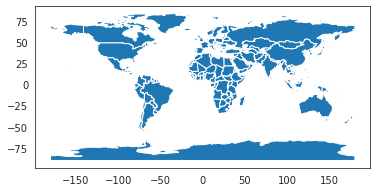

In [45]:
world.plot()

<AxesSubplot:>

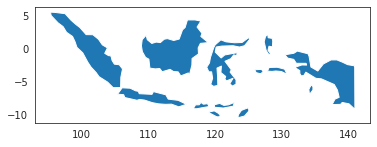

In [46]:
world[world['name'] == 'Indonesia'].plot()

In [47]:
test = gpd.read_file('map.shp')

<AxesSubplot:>

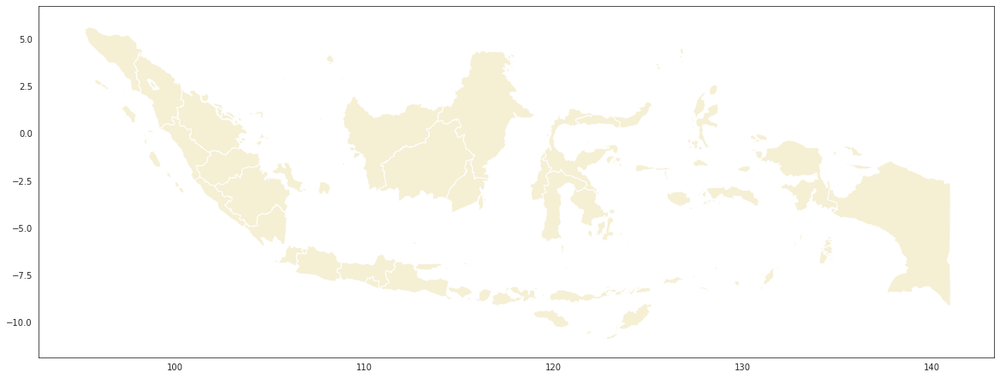

In [48]:
test.plot(figsize=(20,16), color = '#F5EFD4')

In [59]:
#RiverKal['Nama'].unique()
#[RiverKal['Nama'] == 'Java']
test.head(5)

,PROPINSI_,KODE_PROV,KODE,geometry
0,Bali,51,51,"MULTIPOLYGON (((115.23514 -8.81027, 115.23024 ..."
1,Banten,36,36,"MULTIPOLYGON (((106.32700 -5.93086, 106.34032 ..."
2,DI. Yogyakarta,34,34,"POLYGON ((110.49432 -7.76774, 110.51045 -7.770..."
3,DKI Jakarta,31,31,"POLYGON ((106.68526 -6.10193, 106.72242 -6.090..."
4,Jambi,15,15,"MULTIPOLYGON (((104.24754 -1.03300, 104.25315 ..."


<AxesSubplot:>

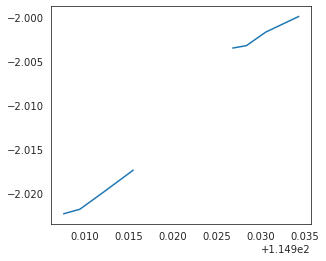

In [57]:
rB = River[River['NAME_0'] == 'Kalimantan']
rB[rB['Nama'] == 'S. Barito'].plot()

In [50]:
River = gpd.read_file('GISData/01 Shapefiles/03_Rivers/Rivers.shp')
RiverKal = River[River['NAME_0'] == 'Kalimantan']

adm = gpd.read_file('GISData/01 Shapefiles/01_admin_divisions/Provinces.shp')
KSouth = adm[adm['NAME_0'] == 'Kalimantan']

roads = gpd.read_file('GISData/01 Shapefiles/06_Roads/Roads.shp')
KRoads = roads[roads['NAME_0'] == 'Kalimantan']

admV = gpd.read_file('GISData/01 Shapefiles/01_admin_divisions/Regencies.shp')
dis = ['Katingan', 'Pulang Pisau', 'Kapuas', 'Barito Selatan', 'Barito Timur','Barito Utara','Murung Raya', 'Palangka Raya', 'Gunung Mas']
admV1 = admV[admV['NAME_2'].isin(dis)]

In [268]:
#RiverKal[RiverKal['Nama'] == 'S. Barito']

data_json = json.loads(KSouth.to_json())

with open('KalAdmGeo.json', 'w') as outfile:
    json.dump(data_json, outfile)
    

with open('KalAdmGeo.json', 'r', encoding='utf8') as openfile: 
        # Reading from json file 
        geo_json = GeoJSONDataSource(geojson=openfile.read())
        

data_json1 = json.loads(RiverKal.to_json())

with open('KalRiver.json', 'w') as outfile1:
    json.dump(data_json1, outfile1)
    

with open('KalRiver.json', 'r', encoding='utf8') as openfile2: 
        # Reading from json file 
        geo_json1 = GeoJSONDataSource(geojson=openfile2.read())
        

data_json2 = json.loads(admV1.to_json())

with open('KCentral.json', 'w') as outfile3:
    json.dump(data_json2, outfile3)
    

with open('KCentral.json', 'r', encoding='utf8') as openfile4: 
        # Reading from json file 
        geo_json2 = GeoJSONDataSource(geojson=openfile4.read())
        


In [260]:
RiverKal

,Nama,Orde,Kode_unsur,ID_0,NAME_0,geometry
461,S. Kembalun,9,0,2,Kalimantan,"LINESTRING Z (118.81213 0.95367 0.00000, 118.8..."
462,None,9,0,2,Kalimantan,"LINESTRING Z (118.57938 0.89824 0.00000, 118.5..."
463,S Semberang,9,0,2,Kalimantan,"LINESTRING Z (118.52948 0.90597 0.00000, 118.5..."
472,S. Membar,9,0,2,Kalimantan,"LINESTRING Z (118.53259 1.00025 0.00000, 118.5..."
7505,S. Ambawang,1,41,2,Kalimantan,"LINESTRING Z (109.47260 -0.05966 0.00000, 109...."
...,...,...,...,...,...,...
12043,None,0,0,2,Kalimantan,"LINESTRING Z (117.00020 2.79612 0.00000, 117.0..."
12044,None,0,0,2,Kalimantan,"LINESTRING Z (117.31990 2.00002 0.00000, 117.3..."
12045,None,0,0,2,Kalimantan,"LINESTRING Z (117.31990 2.00002 0.00000, 117.3..."
12046,None,0,0,2,Kalimantan,"LINESTRING Z (117.21050 3.75676 0.00000, 117.2..."


In [262]:
p = figure(match_aspect=True, x_axis_location = None, y_axis_location = None,
            tools = 'pan, wheel_zoom, box_zoom, reset, save')
#

a = p.patches('xs', 'ys', fill_alpha = 0.7, line_width = .6, source = geo_json, line_cap=None, line_color='black',
            fill_color = '#F5EFD4')  #F7F6F1

r = p.patches('xs', 'ys', fill_alpha = .9, line_width = .88, source = geo_json1, line_cap=None, line_color='lightblue',
            fill_color = 'lightblue')


x = [ 114.6, 114.8, 114.92, 114.85, 114.9, 114.85, 114.59, 113.57]
y = [ -.63, -.605, -.88, -.95, -1.31, -1.36, -2.73, -3.09]
SLabels = ['Puruk Cahu', 'Muara Tuhup', 'Hasan Baskri Bridge', 'Muara Tewen', 'Tarusan',
           'Teluk Siwak', 'Ujung Rumput','Taboneo Anchorage']

SColors = Viridis[11][3:] #['#432371', '#5D3772', '#774B74', '#915F75', '#AC7277', '#C68678', '#E09A7A', '#FAAE7B']

Stations = pd.DataFrame(dict(x=x, y=y, L=SLabels, c=SColors))

srcS = ColumnDataSource(Stations)

t = p.triangle_pin('x', 'y', size = 15, line_color='black', alpha=.7, line_width=.5, color='c', source=srcS)

p.add_layout(t)
p.add_layout(a)
p.add_layout(r)

cL = Label(x=200, y=500, x_units='screen', y_units='screen', 
                        text='Province', render_mode='css', text_font_size='18pt', text_color=Viridis[11][3],
                        text_align='center', angle=0, text_alpha=1, text_font_style='bold', text_font='times')
p.add_layout(cL)

cL1 = Label(x=200, y=470, x_units='screen', y_units='screen', 
                        text='Kalimantan', render_mode='css', text_font_size='18pt', text_color=Viridis[11][3],
                        text_align='center', angle=0, text_alpha=1, text_font_style='bold', text_font='times')
p.add_layout(cL1)

cL2 = Label(x=25, y=60, x_units='screen', y_units='screen', 
                        text='■', render_mode='css', text_font_size='13pt', text_color='lightblue',
                        text_align='center', angle=0, text_alpha=1, text_font_style='bold', text_font='times')
p.add_layout(cL2)

cL3 = Label(x=60, y=63, x_units='screen', y_units='screen', 
                        text='Watershed', render_mode='css', text_font_size='10pt', text_color='black',
                        text_align='center', angle=0, text_alpha=1, text_font='times')
p.add_layout(cL3)

#p.legend.orientation ='horizontal'
#p.legend.background_fill_alpha=None
#p.legend.border_line_color = None
#p.legend.border_line_color = None
#p.legend.background_fill_color=None
#p.legend.click_policy="hide"
#p.legend.title='↓ Disable/Enable'

hv = HoverTool()
hv.tooltips=[('County', '@NAME_1')]

#hv1 = HoverTool()
#hv1.tooltips=[('River', '@Nama')]

hvL = HoverTool()
hvL.tooltips=[('Station', '@L')]

    #plot style
p.add_tools(hv)
p.add_tools(hvL)

#p.add_tools(hv1)

p.hover.renderers = [t]
p.hover.mode = 'mouse'
p.toolbar.autohide = True
#p.axis.ticker.desired_num_ticks = 25

p.grid.grid_line_color=None
p.outline_line_color=None

show(p)

In [269]:
p1 = figure(match_aspect=True, x_axis_location = None, y_axis_location = None,
            tools = 'pan, wheel_zoom, box_zoom, reset, save')
#

a1 = p1.patches('xs', 'ys', fill_alpha = 0.7, line_width = .6, source = geo_json2, line_cap=None, line_color='black',
            fill_color = '#F5EFD4')  #F7F6F1
p1.add_layout(a1)

hvD = HoverTool()
hvD.tooltips=[('County', '@NAME_2')]

p1.add_tools(hvD)


show(p1)



In [60]:
geo = gpd.read_file('GISData/01 Shapefiles/04_Geology/geo_map.shp')

<AxesSubplot:>

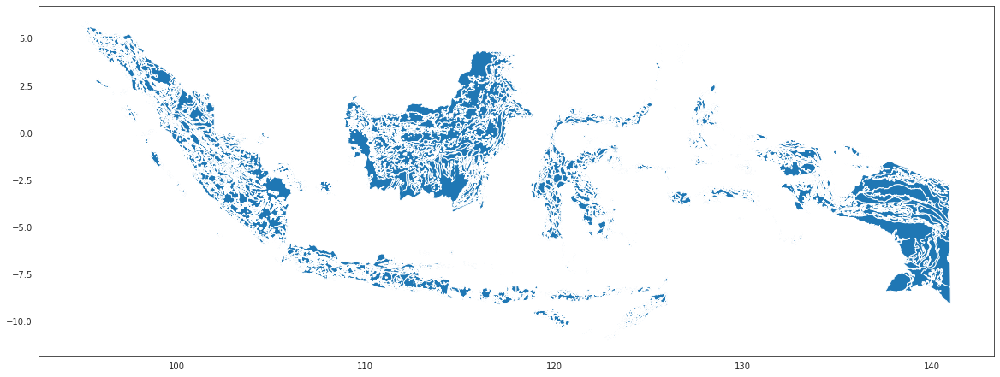

In [62]:
geo.plot(figsize=(20,16))

<AxesSubplot:>

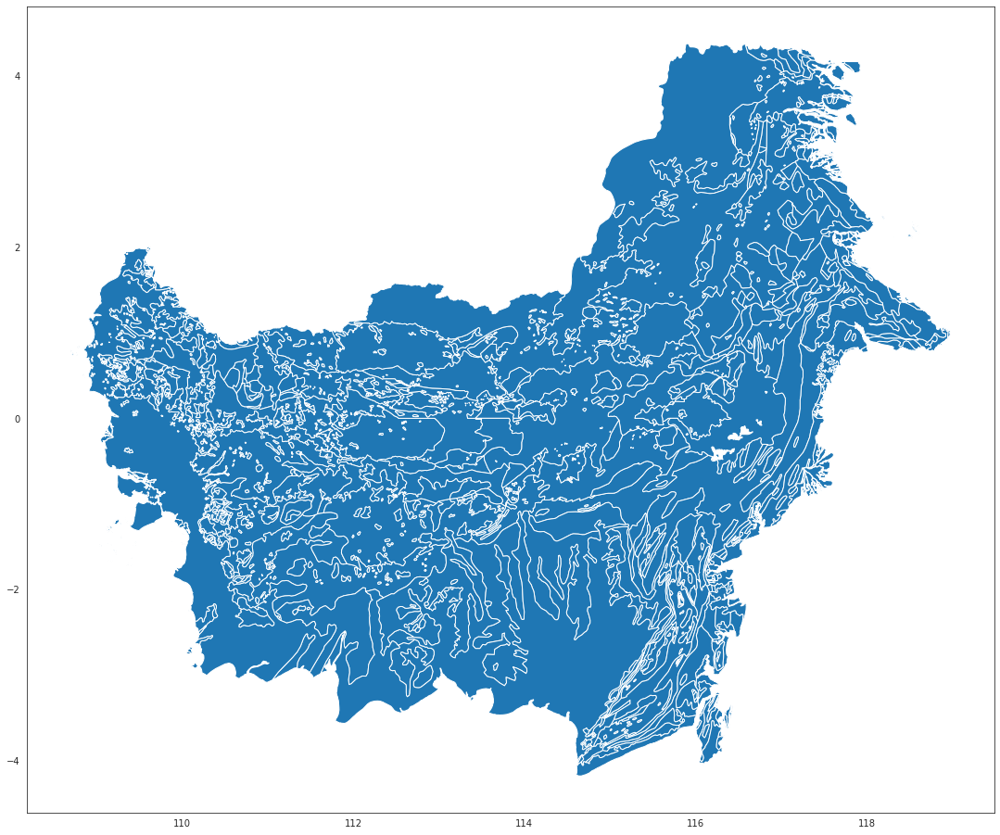

In [66]:
geo[geo['NAME_0'] == 'Kalimantan'].plot(figsize=(20,16))